# You should probably interact with your data more
> Data Visualisation from the ground up with Audio data in Python using Jupyter Notebooks

- toc: true 
- badges: true
- comments: true
- hide: true
- image: images/copied_from_nb/my_icons/crossover.png
- categories: [jupyter, optimisation, visualisation]

# What are we doing?

Data sitting on a computer somewhere is pretty dull. If you are working with data, it's a good idea to find lots of ways to interact with it. See plots of the inputs and outputs of your models, plot statistics of it etc. If you work with data specific to your field, there'll likely be lots of ways you can think of to interact with it.

For example if it's images, look at them. If you transform your data for any reason, look at them before and after the transformation. It sounds obvious but I beleive it can be overlooked by machine learning engineers / data scientists because building tools or bespoke visualisations to interact with data can sometimes feels out of the scope of their responsibilities.

Ok, preaching aside, let's create something that will help people who work with audio within Jupyter notebooks to interact with it. First things first we want to be able to hear it. 

The end goal is to have a bidirectional interactive audio plot for interacting with audio visualisation plots like this tweet.
> twitter: https://twitter.com/_ScottCondron/status/1284495384241479681

Conveniently, IPython comes with lots of out-of-the-box ways to display data. Here's one for audio:

In [7]:
from IPython import display
audio_path = "./my_icons/blah.wav"
display.Audio(filename=audio_path)

Although this lets us _hear_ the audio, what if we want to _see_ it? Let's first look at what's inside it:

In [8]:
from scipy.io import wavfile
sr, wav_data = wavfile.read(audio_path)
print(sr)
print(wav_data.shape)

48000
(775922, 2)


This shows the sample rate is 48000Hz and it has 775922 samples for 2 channels.

In [9]:
wav_data[:,0]

array([-2, -3,  0, ..., -3, -1,  0], dtype=int16)

Seeing audio in a big numpy array isn't very useful. But what if we plot the values:

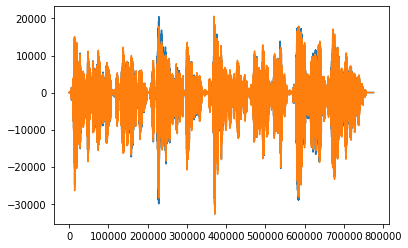

In [10]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.plot(wav_data)
plt.show()

The two channels are on top of eachother. 
We can split them like so:

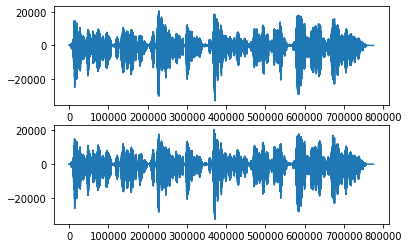

In [11]:
fig, axs = plt.subplots(2)
axs[0].plot(wav_data[:,0])
axs[1].plot(wav_data[:,1])
plt.show()
display.Audio(audio_path)

Although this is nice, I'd like to have the x-axis be seconds rather than samples. I'm going to use the badly named (in my opinion) `numpy.linspace` to do this. It just gives use evenly spaced numbers between `start` and `end`, and we can decide how many numbers.

The duration is just the number of samples divided by the sample rate, and we want the same number of points (to match our y axis).

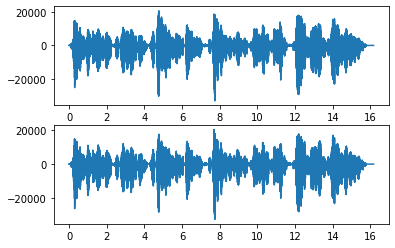

In [12]:
import numpy as np
fig, axs = plt.subplots(2)
duration = len(wav_data)/sr
x = np.linspace(0, duration, len(wav_data))
axs[0].plot(x, wav_data[:,0])
axs[1].plot(x, wav_data[:,1])
plt.show()
display.Audio(audio_path)

Ok, that's better but is there any better way to view audio than using the amplitude of the waveform?? 

Smarter people than me came up with viewing audio _frequencies_ rather than amplitudes. 'Spectrograms' of audio are used to display this. They are visualisations of the frequency changes over time. 

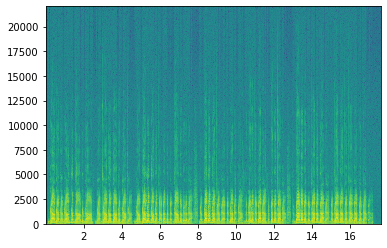

In [13]:
plt.specgram(wav_data[:,0], NFFT=1024, Fs=44100, noverlap=900)
plt.show()
display.Audio(audio_path)

We can do the same thing using scipy to first get the spectogram and then use matplotlib to plot it with a colormesh

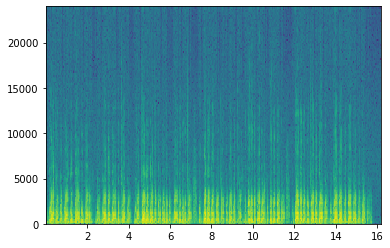

In [14]:
from scipy.signal import spectrogram
f, t, sxx = spectrogram(wav_data[:,0], sr)
plt.pcolormesh(t, f, 10*np.log10(sxx))
plt.show()
display.Audio(audio_path)

# Scrub


That's getting us _close_ to what we want, but what we really want is to be able to _interact_ with the plot and hear the audio at the point we interact with. 

For more interactivity, we're going to reach for a different tool other than `matplotlib` and `IPython.display`. `Holoviews` with `Panel` by Anaconda are very nice for custom interactivity. Conveniently for us, Holoviews `Image` component and Panel's `Audio` component are a more powerful than the default IPython one and they play nicely together.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
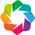

Column
    [0] Audio(ndarray, sample_rate=48000, throttle=500)
    [1] HoloViews(Image)

In [19]:
import holoviews as hv 
import panel as pn
hv.extension("bokeh")

spec_gram = hv.Image((t, f, np.log10(sxx)), ["Time (s)", "Frequency (hz)"]).opts(width=600)
audio = pn.pane.Audio(wav_data[:,0], sample_rate=sr, name='Audio', throttle=500)
pn.Column(audio,
          spec_gram)

In [18]:
from bokeh.resources import INLINE

pn.Column(audio,
          spec_gram).save('audio', embed=True, resources=INLINE)

We want the playhead to update when the time changes while you're playing it. To do this, we'll be using `DynamicMap`, the `Stream` from `audio.param.time` and a callback which returns a `Vline` (the playhead).

In [75]:
def update_playhead(time):
    return hv.VLine(time).opts(color='green')

dmap_time = hv.DynamicMap(update_playhead, streams=[audio.param.time]).opts(width=600)
# pn.Column(audio,
#          spec_gram*dmap_time)
# TODO: Add gif here

That works great, but we also want to be able to click the plot and update the playhead. We do this by merging the two streams to trigger one `update_playhead` callback. `SingleTap` captures when the plot is clicked, and we use Params to update `time` to `t` for the merged callback.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
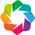

Column
    [0] Audio(ndarray, sample_rate=48000, throttle=500)
    [1] HoloViews(DynamicMap)

In [21]:
from scipy.signal import spectrogram
import holoviews as hv 
import panel as pn
hv.extension("bokeh")

f, t, sxx = spectrogram(wav_data[:,0], sr)
spec_gram = hv.Image((t, f, np.log10(sxx)), ["Time (s)", "Frequency (hz)"]).opts(width=600)
audio = pn.pane.Audio(wav_data[:,0], sample_rate=sr, name='Audio', throttle=500)

def update_playhead(x,y,t):
    if x is None:
        return hv.VLine(t).opts(color='green')
    else:
        audio.time = x
        return hv.VLine(x).opts(color='green')

tap_stream = hv.streams.SingleTap(transient=True)
time_play_stream = hv.streams.Params(parameters=[audio.param.time], rename={'time': 't'})
dmap_time = hv.DynamicMap(update_playhead, streams=[time_play_stream, tap_stream])
pn.Column( audio, 
          (spec_gram * dmap_time))

In [23]:
pn.Column( audio, 
          (spec_gram * dmap_time)).save('audiotest', embed=True, resources=INLINE, max_states=10000)

In [55]:
pause = pn.widgets.Toggle(name='Pause')
pause.jslink(audio, value='paused')
pause

Toggle(name='Pause')

In [30]:
markdown = pn.pane.Markdown("<b>Markdown display</b>", width=400)

In [11]:
markdown = pn.pane.Markdown("<b>Markdown display</b>", width=400)
text_input = pn.widgets.TextInput(value="Markdown display")

code = '''
    target.text = '<b>' + source.value + '</b>'
'''
link = text_input.jslink(markdown, code={'value': code})

pn.Row(text_input, markdown)

Row
    [0] TextInput(value='Markdown display')
    [1] Markdown(str, width=400)

In [13]:
code = '''
    target.text = source.value.toString()
'''

link = audio.jslink(markdown, code={'value': code})
pn.Row(audio, markdown)

Row
    [0] Audio(ndarray, sample_rate=48000, throttle=500, time=1.808367, volume=100)
    [1] Markdown(str, width=400)

In [63]:
audio.jscallback(value="""
if (result.value!="None") {
      result.text = "hello"
}
""", args={'result': markdown})
markdown

AttributeError: 'Markdown' object has no attribute 'text'

In [64]:
audio.jslink(markdown, value='time')

ValueError: Could not jslink 'time' parameter (or property) on Audio object because it was not found.

In [53]:
audio.controls(jslink=True)

Traceback (most recent call last):
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/pyviz_comms/__init__.py", line 315, in _handle_msg
 self._on_msg(msg)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/panel/viewable.py", line 242, in _on_msg
 doc.unhold()
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/document/document.py", line 669, in unhold
 self._trigger_on_change(event)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/document/document.py", line 1132, in _trigger_on_change
 self._with_self_as_curdoc(event.callback_invoker)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/document/document.py", line 1150, in _with_self_as_curdoc
 return f()
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/util/callback_manager.py", line 155, in invoke
 callback(attr, old, new)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/panel/viewable.py", line 494, in _comm_change
 self._process_events({attr: new})
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/panel/viewable.py", line 511, in _process_events
 self.param.set_param(**self._process_property_change(events))
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/param/parameterized.py", line 1365, in set_param
 self_._batch_call_watchers()
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/param/parameterized.py", line 1480, in _batch_call_watchers
 watcher.fn(*events)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/panel/param.py", line 376, in link_widget
 self.object.param.set_param(**{p_name: change.new})
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/param/parameterized.py", line 1365, in set_param
 self_._batch_call_watchers()
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/param/parameterized.py", line 1480, in _batch_call_watchers
 watcher.fn(*events)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/panel/viewable.py", line 789, in param_change
 self._update_model(events, msg, root, model, doc, comm)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/panel/viewable.py", line 767, in _update_model
 model.update(**msg)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/core/has_props.py", line 370, in update
 setattr(self, k, v)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/core/has_props.py", line 274, in __setattr__
 super().__setattr__(name, value)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/core/property/descriptors.py", line 539, in __set__
 self._internal_set(obj, value, setter=setter)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/core/property/descriptors.py", line 760, in _internal_set
 value = self.property.prepare_value(obj, self.name, value)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/core/property/bases.py", line 331, in prepare_value
 raise e
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/core/property/bases.py", line 324, in prepare_value
 self.validate(value)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/core/property/bases.py", line 456, in validate
 raise ValueError(msg)
ValueError: expected a value of type Integral, got 99.6 of type float
 


 Traceback (most recent call last):
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/pyviz_comms/__init__.py", line 315, in _handle_msg
 self._on_msg(msg)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/panel/viewable.py", line 241, in _on_msg
 patch.apply_to_document(doc, comm.id)
 File "/opt/anaconda3/envs/laptop-env/lib/python3.7/site-packages/bokeh/protocol/messages/patch_doc.py", line 100, in apply_to_document
 doc._with_self_as_curdoc(lambda: doc.apply_json_patch(self.content, setter))
 File "/opt/anaconda3/envs/laptop-env/lib/python3.

Tabs
    [0] WidgetBox(name='Controls', width=300)
        [0] StaticText(value='<b>Audio</b>')
        [1] Checkbox(name='Loop')
        [2] Spinner(name='Time', value=1.367938)
        [3] Spinner(name='Throttle', value=500)
        [4] Checkbox(name='Paused', value=True)
        [5] FloatSlider(end=100, name='Volume', value=100)
    [1] WidgetBox(name='Layout', width=300)
        [0] StaticText(value='<b>Audio</b>')
        [1] Select(name='Align', options=OrderedDict([('start', ...]), value='start')
        [2] LiteralInput(name='Aspect ratio', serializer='json')
        [3] LiteralInput(name='Background', serializer='json')
        [4] ListInput(name='Css classes', serializer='json', type=<class 'list'>)
        [5] Spinner(name='Width', start=0)
        [6] Spinner(name='Height', start=0)
        [7] Spinner(name='Min width', start=0)
        [8] Spinner(name='Min height', start=0)
        [9] Spinner(name='Max width', start=0)
        [10] Spinner(name='Max height', start=0)
        [11] LiteralInput(name='Margin', serializer='json', value=5)
        [12] Select(name='Width policy', options=OrderedDict([('auto', ...]), value='auto')
        [13] Select(name='Height policy', options=OrderedDict([('auto', ...]), value='auto')
        [14] Select(name='Sizing mode', options=OrderedDict([('fixed', ...]))

In [ ]:
value1 =   pn.widgets.Spinner(value=0, width=75)
operator = pn.widgets.Select(value='*', options=['*', '+'], width=50, align='center')
value2 =   pn.widgets.Spinner(value=0, width=75)
button =   pn.widgets.Button(name='=', width=50)
result =   pn.widgets.StaticText(value='0', width=50, align='center')

button.jscallback(clicks="""
if (op.value == '*') 
  result.text = (v1.value * v2.value).toString()
else
  result.text = (v1.value + v2.value).toString()
""", args={'op': operator, 'result': result, 'v1': value1, 'v2': value2})

pn.Row(value1, operator, value2, button, result)


## Play with it yourself!

Here it is deployed on PyViz examples: https://genetic-algorithm.pyviz.demo.anaconda.com/GA.

You can also view and run all the code yourself from [here](https://github.com/scottire/examples). Thanks for reading. 

I personally love learning about these kind of algorithms and finding ways to interact with them visually. What do you think about these nature-inspired algorithms? Did you learn a bit about creating interactive visualisations in Python by reading this article? If so, feel free to [share it](https://ctt.ac/4q7IH), and you’re also more than welcome to contact me (via [Twitter](https://twitter.com/_ScottCondron)) if you have any questions, comments, or feedback.

Thanks for reading! :rocket:

[Follow me on Twitter here](https://www.twitter.com/_scottcondron) for more stuff like this.

<a class="twitter-follow-button"
  href="https://twitter.com/_ScottCondron">
Follow @_ScottCondron</a>

<iframe src="https://scottcondron.substack.com/embed" width="480" height="320" style="border:1px solid #EEE; background:white;" frameborder="0" scrolling="no"></iframe>